***
#  <font color=blue>DETECÇÃO DE FRAUDE COM ÁRVORES DE DECISÃO</font>
***

***
# <font color=blue>1. Dataset do Projeto</font>
***

## <font color=blue>1.1. Contexto </font>

Pesquisa da Kaspersky apurou que a fraude com cartão de crédito é ainda grande no país. A pesquisa aponta que ***20% das pessoas  tiveram seu cartão de crédito utilizado sem autorização por terceiros***, número importante quando é levado em conta a quantidade de pessoas que utilizam este meio de pagamento.

É importante que as empresas de cartão de crédito sejam capazes de reconhecer transações fraudulentas com cartão de crédito para que os clientes não sejam cobrados por itens que não compraram e não causarem prejuízos.

## <font color=blue>1.2. Considerações </font>

- Possui transações genuínas feitas por cartões de crédito em set/2013 por titulares de cartões europeus.

- Apresenta transações ocorridas em 2 dias, onde tivemos 492 fraudes em 284.807 transações;

- O conjunto de dados está totalmente desbalanceado, onde a classe positiva (Fraudes) representa 0,172% de todas as transações;

- Os atributos identificados nas colunas por: ***`V1`, `V2`...`V28` *** tiveram seus nomes mascarados por motivos de confidencialidade sobre os dados.

- `Time` - atributo que contém os segundos decorridos entre cada transação e a primeira transação no dataset.

- `Class` - é a variável resposta e assume a seguinte classificação: **Fraudes= 1** e **Não-Fraude= 0**

[Fonte dos Dados](https://www.kaggle.com/datasets/mlg-ulb/creditcardfraud)

## <font color=blue>1.3. Analisando os Dados </font>

### <font color=blue>Importando bibliotecas e lendo o dataset do projeto</font>

In [1]:
# Bibliotecas
%config IPCompleter.greedy=True
import pandas as pd
import numpy as np

In [2]:
# Importando Base de Dados
dados = pd.read_csv('dados/creditcard.csv')
dados.head()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,0.0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,...,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,149.62,0
1,0.0,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,...,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,2.69,0
2,1.0,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,...,0.247998,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,378.66,0
3,1.0,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,...,-0.108300,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,123.50,0
4,2.0,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,...,-0.009431,0.798278,-0.137458,0.141267,-0.206010,0.502292,0.219422,0.215153,69.99,0


### <font color=blue>Verificando os dados</font>

In [3]:
# Nº DE TRANSAÇÕES
n_transacoes = dados.shape[0]
n_fraudes = dados['Class'].value_counts()[1]
n_fraudes_percentual = (n_fraudes/ (n_transacoes - n_fraudes)) *100

print(f'O Dataset possui {n_transacoes} transações e {dados.shape[1]} colunas')
print(f'O Dataset possui {n_fraudes} fraudes, representando {round(n_fraudes_percentual,2)}% do total')

O Dataset possui 284807 transações e 31 colunas
O Dataset possui 492 fraudes, representando 0.17% do total


**NOTA:** Apenas 0.17% dos dados foram classificadas como Fraudes, com isso, podemos dizer que os ***dados estão desbalanceados***

In [4]:
# DADOS NULOS - OK (sem presença de dados nulos)
dados.isnull().sum()

Time      0
V1        0
V2        0
V3        0
V4        0
V5        0
V6        0
V7        0
V8        0
V9        0
V10       0
V11       0
V12       0
V13       0
V14       0
V15       0
V16       0
V17       0
V18       0
V19       0
V20       0
V21       0
V22       0
V23       0
V24       0
V25       0
V26       0
V27       0
V28       0
Amount    0
Class     0
dtype: int64

***
# <font color=blue> 2. Declaração das Funções </font>
***

### <font color=blue>2.1. Função Validador</font>
**Objetivo:** Separar os Dados de Treino e Teste de forma proporcional devido os dados estarem desbalanceados, será usado o método Stratified Shuffle Split.
**Documentação:**[StratifiedShuffleSplit](https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.StratifiedShuffleSplit.html)

In [5]:
from sklearn.model_selection import StratifiedShuffleSplit

def exec_validador(x,y):
    validador = StratifiedShuffleSplit (n_splits=1, test_size= 0.1, random_state=0)
    for treino_id, teste_id in validador.split(x, y):
        x_train, x_test = x[treino_id], x[teste_id]
        y_train, y_test = y[treino_id], y[teste_id]

    print(f'Treinaremos com {x_train.shape[0]} e Testaremos com {x_test.shape[0]} elementos')
    return  x_train, x_test, y_train, y_test

### <font color=blue>2.2. Função: Classificador</font>
**Objetivo:** Gerar o Modelo, Realizar o Treino e a Previsão Gerada

In [6]:
%%time
from sklearn import tree

def exec_classificador(classificador, x_train, x_test, y_train):
    arvore = classificador.fit(x_train, y_train)
    y_pred = arvore.predict(x_test)
    return y_pred

Wall time: 115 ms


### <font color=blue>2.3. Função: Validação do Modelo</font>
**Objetivo:** Gerar métricas para Validação do Modelo

In [7]:
from sklearn import metrics

def validar_arvore(y_test, y_pred):
    print('Accurancy Score: ', np.round(metrics.accuracy_score(y_test, y_pred),4)) 
    print('Precision Score: ', np.round(metrics.precision_score(y_test, y_pred),4))
    print('Recall Score: '   , np.round(metrics.recall_score(y_test, y_pred),4))
    print('Confusion Matrix: ')
    print(metrics.confusion_matrix(y_test, y_pred))

### <font color=blue>2.4. Função: Salvar Modelos</font>
**Objetivo:** Salvar imagens dos Modelos de Árvores para avaliação

In [8]:
import matplotlib.pyplot as plt

def salvar_arvore(classificador, nome):
    plt.figure(figsize=(200,100))
    tree.plot_tree(classificador, filled=True, fontsize=14)
    plt.savefig('modelos/'+ nome)
    plt.close    

***
# <font color=blue> 3. Preparando os Dados </font>
***

In [9]:
# Separando os dados de Atributos (x) e Classe (y)
x = dados.drop('Class', axis=1).values
y = dados['Class'].values

In [10]:
# Execução do Validador passando como parâmetro o split dos dados
x_train, x_test, y_train, y_test = exec_validador(x, y)

Treinaremos com 256326 e Testaremos com 28481 elementos


***
# <font color=blue> 4. Gerando o Modelo </font>
***

In [11]:
#Gerando e Treinando o Modelo
classificador_arvore_decisao= tree.DecisionTreeClassifier(random_state=0)
y_pred_arvore_decisao = exec_classificador(classificador_arvore_decisao, x_train, x_test, y_train )

***
# <font color=blue> 5. Visualizando e Salvando o Modelo </font>
***

In [12]:
# Geração da Imagem da Árvore de Decisão
salvar_arvore(classificador_arvore_decisao, "DecisionTree_0.png")

***
# <font color=blue> 6. Avaliando as Métricas </font>
***

In [13]:
print('Profundidade da Árvore:', classificador_arvore_decisao.get_depth())

Profundidade da Árvore: 21


In [52]:
# Chama a função de Validação do Modelo
validar_arvore(y_test, y_pred_arvore_decisao)

Accurancy Score:  0.9994
Precision Score:  0.8605
Recall Score:  0.7551
Confusion Matrix: 
[[28426     6]
 [   12    37]]


**Resultado:** Este modelo foi gerado sem restrições, ou seja, a estrutura da árvore se adaptará aos dados de treinamento, assim como aconteceu de acordo com a Acurácia de 0.9991 gerando um ***overfiting***. Para evitar isto, é necessário restringir a liberdade da Árvore de Decisão com os ***Hiperparâmetros de Regularização*** que serão utilizados no item 7.

### <font color=blue>6.1. Analisando as Métricas com base na Matriz de Confusão</font>

A matriz de confusão diz exatamente quantas transações foram classificadas corretamente, quantas dessas transações eram transações com fraude, quantas dessas transações eram transações sem fraude. Então ela nós dá exatamente esses valores e a partir desses valores podemos entender melhor sobre as métricas utilizadas.

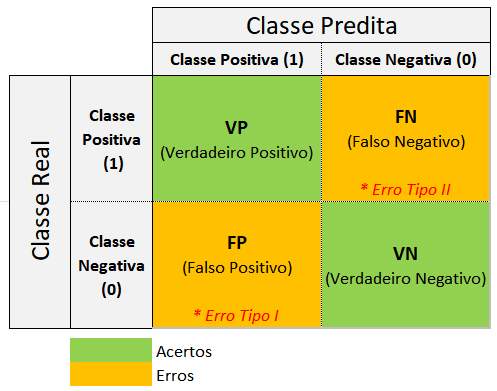



Legenda: 
- VP: Transações de Fraude, classificadas como Fraude
- VN: Transações de Não-Fraude, classificadas como Não-Fraude
- FP: Transações de Fraude, classificadas como Não-Fraude
- FN: Transações de Não-Fraude, classificadas como Fraude

NOTA: O tópico não faz parte da solução do problema, mas uma forma exemplificada para entendermos as métricas utilizando a Matriz de Confusão.

#### <font color=blue>i) Calculando a Acurácia</font>
Indica uma performance geral do modelo, dentre todas as classificações, quantas o modelo classificou corretamente como Verdadeiros(VP + VN). É uma ótima métrica quando os dados estão balanceados, caso contrário, pode causar uma falsa impressão de bom desempenho que é este caso,  onde a Classe Positiva representa apenas 0,17% do dataset.

$$Acurácia: \frac{(VP + VN)}{(VP + VN + FP + FN)}$$

Legenda:
- (VP + VN): y_pred
- (VP + VN + FP + FN): y_test


In [53]:
# Calculando Accurancy Score usando a Matriz de Confusão
from sklearn.metrics import confusion_matrix

vp = confusion_matrix(y_test, y_pred_arvore_decisao)[0][0]
vn = confusion_matrix(y_test, y_pred_arvore_decisao)[1][1]
fp = confusion_matrix(y_test, y_pred_arvore_decisao)[1][0]
fn = confusion_matrix(y_test, y_pred_arvore_decisao)[0][1]

acc_score = (vp+vn) / y_test.shape[0]

print(f'Nº de Acertos (VP + VN)= ', (vp+vn))
print(f'Nº de Transações Total = ', y_test.shape[0])
print(f' Nº de Erros (FP + FN) = ', y_test.shape[0] - (vp+vn))
print( 'Acuracidade Calculada = ', round(acc_score,4))

Nº de Acertos (VP + VN)=  28463
Nº de Transações Total =  28481
Nº de Erros Total =  18
Acuracidade Calculada =  0.9994


#### <font color=blue>ii) Calculando a Precisão</font>
Precisão também conhecida como Valor Preditivo Positivo (VPP), ela nos traz a informação da quantidade de observações classificadas como Positiva (1) e que realmente são Positivas (VP). Ou seja, entre todas as transações identificadas como positivas (1), quantas foram identificadas corretamente.

$$Precisão: \frac{VP}{VP + FP}$$

Acertamos praticamente 100% das TRANSAÇÕES COM FRAUDE, mas também acabamos classificando muitas TRANSAÇÕES NÃO-FRAUDES.

E qual o problema disso? 

O problema é que o banco vai receber ligação falando que o cliente teve o cartão bloqueado, mas foi ele quem fez a transação. Imagine o tanto de ligações que um banco, que a empresa de cartão de crédito iria receber se classificasse 28 mil transações como transações com fraudes.

In [56]:
# Calculando o Precision Score
                                                                          
precision_score = vp / (vp + fp)

print(f'Nº de Acertos Operações com Fraude (VP) = ', vp)
print(f'Nº de Acertos Positivo (VP) + Falso Positivo (FP) = ', (vp + fp))
print(f'Nº de Erros (FP) = ', fp)
print('Precisão Calculada = ', round(precision_score,4))

Nº de Acertos Operações com Fraude (VP) =  28426
Nº de Acertos Positivo (VP) + Falso Positivo (FP) =  28438
Nº de Erro (FP) =  12
Precisão Calculada =  0.9996


**Comentários:** Neste indicador identificamos 12 transações como Falso Positivos, ou seja, a operadora do cartão não iria conseguir identificar (Falso) como Fraudes (Positivo), podendo gerar um prejuízo para a companhia.

#### <font color=blue>iii) Calculando o Recall/ Sensibilidade</font>
Recall ou Sensibilidade é a proporção dos Verdadeiros Positivos (VP) entre todas as observações que realmente são positivas no seu conjunto de dados.  Ou seja, entre todas as observações que são positivas quantas o modelo conseguiu identificar como positiva. Ou seja, representa a capacidade de um modelo em prever a classe positiva.


$$Recall: \frac{VP}{VP + FN}$$


In [58]:
# Calculando o Recall Score

recall_score = vp / (vp + fn)

print(f'Nº de Acertos em Operações com Fraude (VP) = ', vp)
print(f'Nº de Acertos (VP) + Transações classificadas como Fraude (FN) = ', (vp + fn))
print(f'Nº de Erros (FN) = ', fn)
print('Recall Calculado = ', round(recall_score, 4))

Nº de Acertos em Operações com Fraude (VP) =  28426
Nº de Acertos (VP) + Transações classificadas como Fraude (FN) =  28432
Nº de Erros (FN) =  6
Recall Calculado =  0.9998


**Comentários:** Neste cálculo do Recall, como por exemplo: teríamos 6 clientes insatisfeitos ligando para as operadoras do cartão devido seu cartões serem bloqueados por engano.

***
# <font color=blue> 7. Ajustando o Modelo </font>
***

Agora vamos entender um pouco as características da nossa árvore de decisão, para vermos se conseguimos alterar algum parâmetro e assim melhorarmos o resultado daquelas métricas que vimos anteriormente.

### <font color=blue>7.1. Decision Tree </font>

#### <font color=blue>i) Teste 01 </font>
***Hiperparâmetro de Regularização:***`max_depth`

***Objetivo:*** Restringuir a Profundidade da Árvore de Decisão afim de, reduzir a complexidade do modelo e consequentemente evitar o Overfiting.

Quanto mais profunda for essa árvore, maior é a probabilidade da árvore de decisão estar sujeita á overfit - que é quando a nossa árvore fica especializadas demais, fica com regras específicas demais e acaba ficando especializada na base de dados de treino, enquanto ela não performa muito bem nas bases de dados de teste.

***Resultado:*** <code style="color:green">( OK ) -> Houve melhorias significativas </code>

In [18]:
#Gera e Treina o Modelo
classificador_arvore_decisao= tree.DecisionTreeClassifier(random_state=0, max_depth = 10)
y_pred_arvore_decisao = exec_classificador(classificador_arvore_decisao, x_train, x_test, y_train )

In [19]:
# Salva o Modelo
salvar_arvore(classificador_arvore_decisao, "DecisionTree_1.png")

In [20]:
# Valida o Modelo
validar_arvore(y_test, y_pred_arvore_decisao)

Accurancy Score:  0.9995
Precision Score:  0.9474
Recall Score:  0.7347
Confusion Matrix: 
[[28430     2]
 [   13    36]]


#### <font color=blue>ii) Teste 02  </font>
***Hiperparâmetro de Regularização:*** `min_samples_leaf=10`

***Objetivo:*** Definir o número mínimo de amostras que um nó da folha deve ter, afim de, evitar o risco de Overfiting.
 

In [21]:
#Gera e Treina o Modelo
classificador_arvore_decisao= tree.DecisionTreeClassifier(random_state=0, max_depth = 10, min_samples_leaf=10)
y_pred_arvore_decisao = exec_classificador(classificador_arvore_decisao, x_train, x_test, y_train )

In [22]:
# Salva o Modelo
salvar_arvore(classificador_arvore_decisao, "DecisionTree_2.png")

In [23]:
# Verifica a Validação
validar_arvore(y_test, y_pred_arvore_decisao)

Accurancy Score:  0.9994
Precision Score:  0.8605
Recall Score:  0.7551
Confusion Matrix: 
[[28426     6]
 [   12    37]]


***Resultado:*** <code style="color:red">( NOK ) -> Não será aplicado no modelo, Precision Score piorou</code>

### <font color=blue>7.2. Random Forest</font>

#### <font color=blue>i) Teste 01</font>
***Hiperparâmetro de Regularização:***` n_estimators= 100`, `random_state=0` 

In [24]:
%%time
from sklearn.ensemble import RandomForestClassifier

#Gera e Treina o Modelo
classificador_random_forest = RandomForestClassifier(n_estimators= 100, random_state=0 )
y_pred_random_forest = exec_classificador(classificador_random_forest, x_train, x_test, y_train)

Wall time: 3min 35s


In [25]:
# Salva o Modelo
salvar_arvore(classificador_random_forest.estimators_[0], "RandomForest_1")

In [26]:
# Valida o Modelo
validar_arvore(y_test, y_pred_random_forest)

Accurancy Score:  0.9995
Precision Score:  0.9487
Recall Score:  0.7551
Confusion Matrix: 
[[28430     2]
 [   12    37]]


***Resultado:*** <code style="color:red">( NOK ) -> Não será aplicado no modelo, melhoria não significante </code>

#### <font color=blue>ii) Teste 02 </font>
***Hiperparâmetro de Regularização:***` n_estimators= 50`, `random_state=0`, `max_depth=10`

In [27]:
%%time
from sklearn.ensemble import RandomForestClassifier

#Gera e Treina o Modelo
classificador_random_forest = RandomForestClassifier(n_estimators= 50, random_state=0, max_depth=10 )
y_pred_random_forest = exec_classificador(classificador_random_forest, x_train, x_test, y_train)

Wall time: 1min 6s


In [28]:
# Salva Modelo
salvar_arvore(classificador_random_forest.estimators_[0], "RandomForest_2")

In [29]:
# Valida o Modelo
validar_arvore(y_test, y_pred_random_forest)

Accurancy Score:  0.9995
Precision Score:  0.9737
Recall Score:  0.7551
Confusion Matrix: 
[[28431     1]
 [   12    37]]


***Resultado:*** <code style="color:green">( OK ) -> Será aplicado estes ajustes no modelo, melhorias significantes em Precision e Recall Scores</code>

### <font color=blue>7.3. Ada Boost </font>

#### <font color=blue>i) Teste 01 </font>
***Sem Regularização:*** `random_state=0`

In [31]:
%%time
from sklearn.ensemble import AdaBoostClassifier

#Gera e Treina o Modelo
classificador_adaboost = AdaBoostClassifier(random_state=0)
y_pred_adaboost = exec_classificador(classificador_adaboost, x_train, x_test, y_train)

Wall time: 1min 1s


In [32]:
# Salva Modelo
salvar_arvore(classificador_adaboost.estimators_[0], "AdaBoost_1")

In [33]:
# Valida o Modelo
validar_arvore(y_test, y_pred_adaboost)

Accurancy Score:  0.9993
Precision Score:  0.8889
Recall Score:  0.6531
Confusion Matrix: 
[[28428     4]
 [   17    32]]


***Resultado:*** <code style="color:red">( NOK ) -> Não será aplicado estes ajustes no modelo, piora significativa  em Precision e Recall Scores </code>

#### <font color=blue>ii) Teste 02 </font>
***Hiperparâmetro de Regularização:***` n_estimators= 100`

In [34]:
%%time
from sklearn.ensemble import AdaBoostClassifier

#Gera e Treina o Modelo
classificador_adaboost = AdaBoostClassifier(random_state=0, n_estimators=100)
y_pred_adaboost = exec_classificador(classificador_adaboost, x_train, x_test, y_train)

Wall time: 2min 4s


In [35]:
# Salva Modelo
salvar_arvore(classificador_adaboost.estimators_[0], "AdaBoost_2")

In [36]:
# Valida Modelo
validar_arvore(y_test, y_pred_adaboost)

Accurancy Score:  0.9994
Precision Score:  0.8636
Recall Score:  0.7755
Confusion Matrix: 
[[28426     6]
 [   11    38]]


***Resultado:*** <code style="color:red">( NOK ) -> Não será aplicado estes ajustes no modelo, piora significante em Precision Score </code>


***
# <font color=blue> 8. Conclusão </font>
***

No primeiro teste já foi identificado um Overfiting do modelo devido o modelo estar desbalanceado, com isso, afim de termos um modelo com resultados eficazes, foi considerado as Métricas de Precisão e Recall, afim de, avaliarmos com mais detalhes o modelo e reduzir os erros (Falsos Positivos e Falsos Negativos) já que estes são cruciais para este caso. 

Foram utilizados 3 modelos, como: Decision Tree, Random Forest, Ada Booster com regularização de hiperparâmetros, onde após alguns testes o melhor resultado foi obtido com o ***Modelo Random Forest***:

***Accurancy Score:  0.9995 | Precision Score:  0.9737 | Recall Score:  0.7551***

De acordo com o Recall e a Matriz de Confusão, teremos 12 operações com cartão de crédito bloqueados como Fraudes (Falso Positivo), onde a operadora, em seguida poderá enviar um SMS ou popup no Aplicativo solicitando o reconhecimento da compra, liberando após a confirmação.